## Initial Set Up

In [1]:
# Set Up Environment
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

## Helper Functions
All the functions used to set up the final pipeline

In [2]:
# Identifies image and object points and calibrates the camera
def calibrate_camera():
    # This functions calibrates the camera to get calibration matrix and distortion coefficients
    # by running through a series of images
    
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.
    
    # Make a list of calibration images
    images = ['camera_cal/'+image for image in os.listdir('camera_cal/')]
    
    # Step through the list and search for chessboard corners
    for fname in images:
        img = cv2.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        #gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        
        #Detect chessboard corners of the distorted image in grayscale image
        ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
        
        #Append object and image points
        if ret == True:
            #Append the corners to the image points 
            objpoints.append(objp)
            imgpoints.append(corners)
        
    #Calibrate the camera to obtain calibration matrix and distortion coefficients
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
        
    return mtx, dist

In [3]:
# Same as above function, but used to step through and visualize the process
# used for README.md
def show_checkerboard_calibration():
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.
    
    # Make a list of calibration images
    images = ['camera_cal/'+image for image in os.listdir('camera_cal/')]
    
    # Initialize count for file names
    count = 1
    
    # Step through the list and search for chessboard corners
    for fname in images:
        img = cv2.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

            # Draw and display the corners
            cv2.drawChessboardCorners(img, (9,6), corners, ret)
            f, (ax1, ax2) = plt.subplots(1, 2, figsize=(8,4))
            ax1.imshow(cv2.cvtColor(mpimg.imread(fname), cv2.COLOR_BGR2RGB))
            ax1.set_title('Original Image' + '\n' + fname[11:-4], fontsize=12)
            ax2.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            ax2.set_title('With Corners' + '\n' + fname[11:-4], fontsize=12)
            cv2.imwrite('output_images/camera_cal/'+str(count)+'.jpg', img)
            count+=1

In [4]:
# Uses camera calibration matrix and distortion coefficients to undistort an image
def undistort_image(image, mtx, dist):
        undist_image = cv2.undistort(image, mtx, dist, None, mtx)
        
        return undist_image

In [5]:
# Transforms the perspective of the image to "bird's eye view"
def transform_perspective(image):
    # Define the four source points
    src = np.array([[200,720], [1150, 720], [750, 480], [550, 480]], np.float32)
    
    # Define the four destination points
    dst = np.array([[300,720], [900, 720], [900, 0], [300, 0]], np.float32)
    
    # Get the transformation matrix by performing perspective transform
    M = cv2.getPerspectiveTransform(src, dst)
    
    # Get the inverse transformation matrix 
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # Get the image size 
    image_size = (image.shape[1], image.shape[0])
    
    # Warp the image 
    warped_image = cv2.warpPerspective(image, M, image_size)
    
    return warped_image, M, Minv

In [6]:
# Reverses the perspective transform of an image
def reverse_transform_perspective(image, matrix):
    image_size = (image.shape[1], image.shape[0])
    reversed_image = cv2.warpPerspective(image, matrix, image_size)
    return reversed_image

In [7]:
# Define a function that takes an image, gradient orientation,
# and threshold min / max values.
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output

In [8]:
# Define a function to return the magnitude of the gradient
# for a given sobel kernel size and threshold values
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

In [9]:
# Define a function to threshold an image for a given range and Sobel kernel
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

In [10]:
def hls_threshold(image, channel, thresh=(0, 255)):
    """This function applies threshold to saturation colour space to detect the lane line"""
        
    # Convert the image to HLS colour space
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    
    if channel == 'S':
        # Separate the 'S' channel
        C = hls[:,:,2]
    elif channel == 'L':
        # Separate the 'L' channel
        C = hls[:,:,1]
    elif channel == 'H':
        # Separate the 'H' channel
        C = hls[:,:,0]
    
    #  Apply a threshold to the S channel
    binary_output = np.zeros_like(C)
    binary_output[(C > thresh[0]) & (C <= thresh[1])] = 1
    
    return binary_output

In [11]:
def hsv_threshold(image, channel, thresh=(0, 255)):
    """This function applies threshold to saturation colour space to detect the lane line"""
        
    # Convert the image to HSV colour space
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    if channel == 'V':
        # Separate the 'V' channel
        C = hsv[:,:,2]
    elif channel == 'S':
        # Separate the 'S' channel
        C = hsv[:,:,1]
    elif channel == 'H':
        # Separate the 'H' channel
        C = hsv[:,:,0]
    
    #  Apply a threshold to the S channel
    binary_output = np.zeros_like(C)
    binary_output[(C > thresh[0]) & (C <= thresh[1])] = 1
    
    return binary_output

In [12]:
yellow_lower = np.array([0,100,100])
yellow_upper = np.array([80,255,255])
white_lower = np.array([0,0,230])
white_upper = np.array([255,80,255])

def color_threshold(image, lower_thresh, upper_thresh):

    # Convert RGB to HSV
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)

    # Threshold the HSV image to get only desired colors
    mask = cv2.inRange(hsv, lower_thresh, upper_thresh)
    
    #  Apply a threshold to the desired color
    binary_output = np.zeros_like(hsv)
    binary_output[(hsv > lower_thresh) & (hsv <= upper_thresh)] = 1

    # Bitwise-AND mask and original image
    res = cv2.bitwise_and(image,image, mask= mask)

    return mask

In [13]:
def hist(img):
    # Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car
    bottom_half = img[img.shape[0]//2:,:]
    histogram = np.sum(bottom_half, axis=0)
    
    return histogram

In [14]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img

In [39]:
def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    ###plt.plot(left_fitx, ploty, color='yellow')     # <--- uncomment to toggle
    ###plt.plot(right_fitx, ploty, color='yellow')    # <--- yellow polynomial lines

    return out_img, ploty, (left_fit, right_fit), (left_fitx, right_fitx)

In [16]:
def fit_poly(img_shape, leftx, lefty, rightx, righty):
    # Fit a second order polynomial to each side
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    # Calculate both polynomials using ploty, left_fit and right_fit
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty

In [40]:
def fill_lane_lines(binary_warped):
    # Width of lane line margin shown in image
    margin = 50
    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Set the area of search based on activated x-values
    # within the +/- margin of our polynomial function

    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))
    
    both_lines_1 = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    both_lines_2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx, 
                              ploty])))])
    
    all_line_pts = np.hstack((both_lines_1, both_lines_2))

    # Draw the lane onto the warped blank image
    ###cv2.fillPoly(window_img, np.int_([left_line_pts]), (0, 0, 255))
    ###cv2.fillPoly(window_img, np.int_([right_line_pts]), (0, 0, 255))
    cv2.fillPoly(window_img, np.int_([all_line_pts]), (0, 255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, .3, 0)
    
    # Plot the polynomial lines onto the image
    ###plt.plot(left_fitx, ploty, color='yellow')     # <--- uncomment to toggle
    ###plt.plot(right_fitx, ploty, color='yellow')    # <--- yellow polynomial lines
    ## End visualization steps ##
    
    return out_img, result, left_fitx, right_fitx

## Camera Calibration

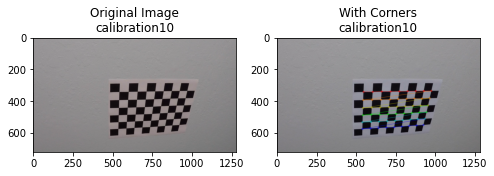

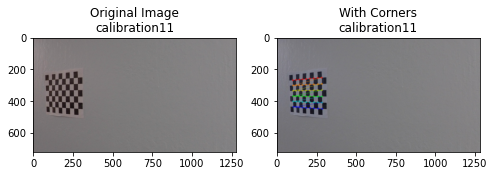

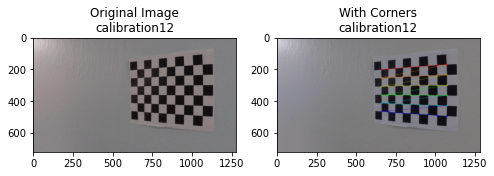

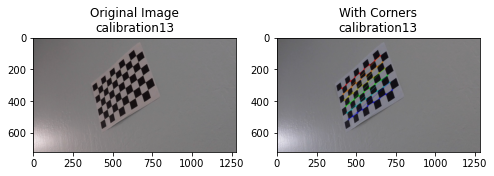

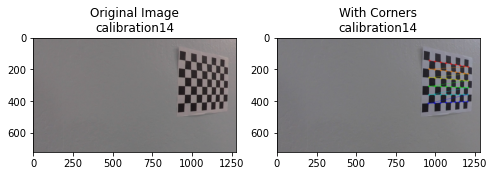

...

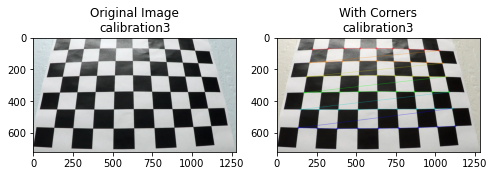

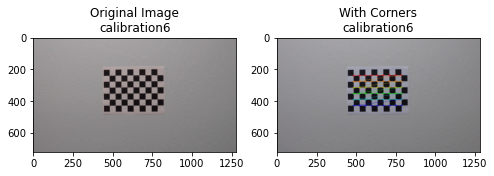

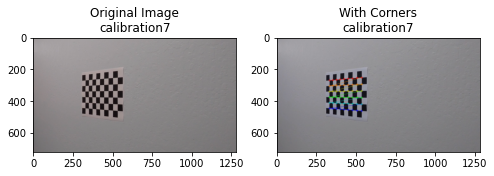

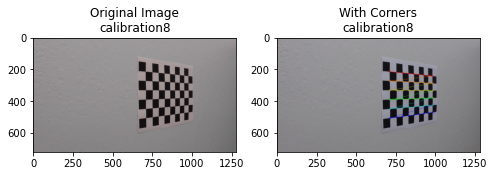

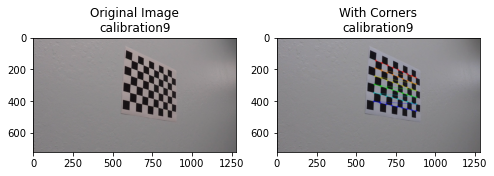

In [18]:
# Create and store camera calibration matrix and distortion coefficients
mtx, dist = calibrate_camera()

# Visualize this process for each test image
show_checkerboard_calibration()

## Visualize Undistorted Images

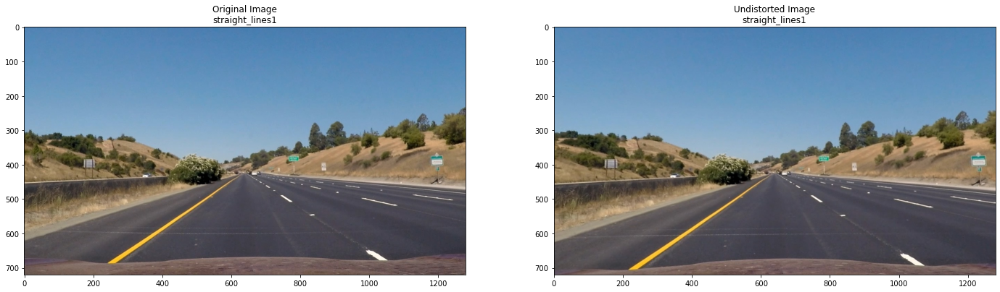

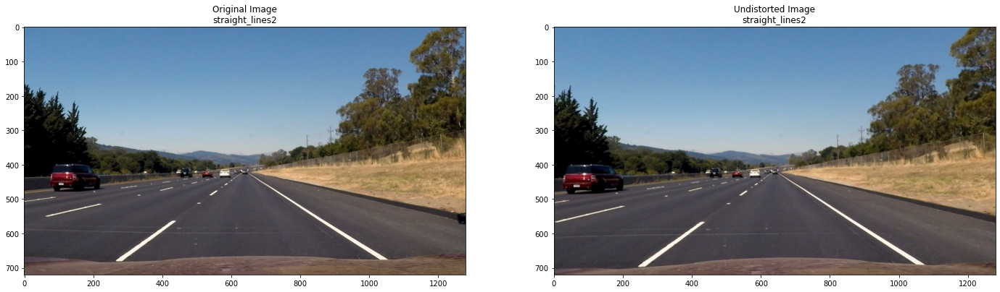

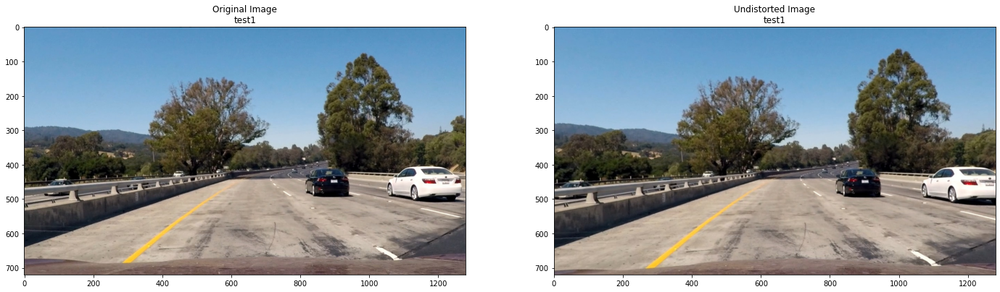

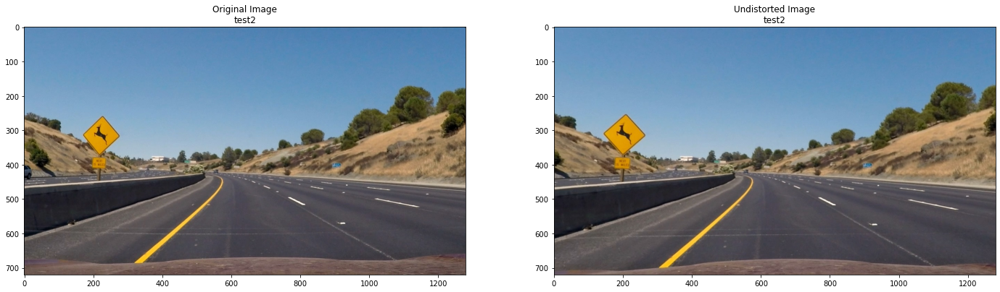

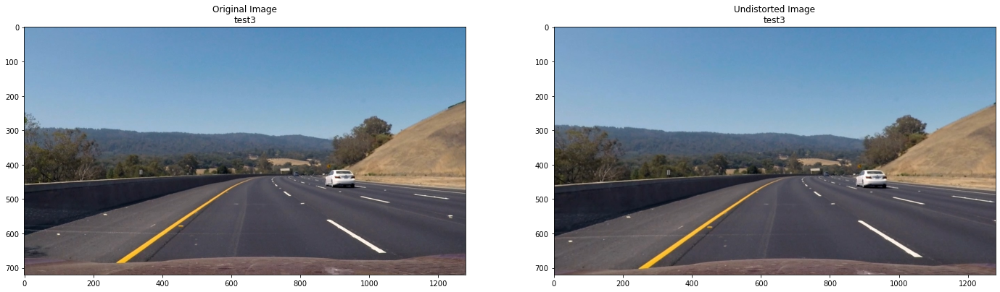

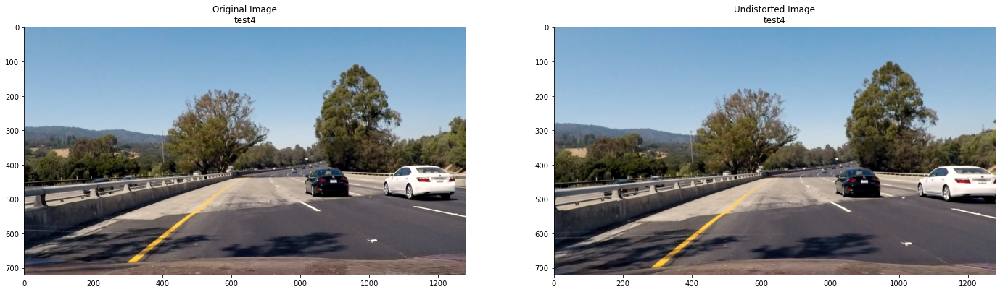

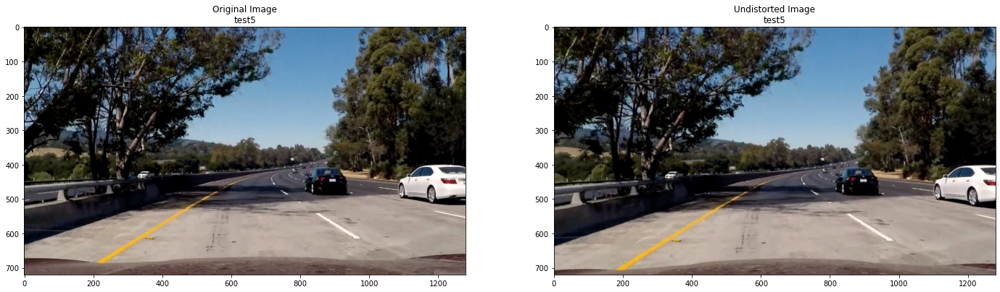

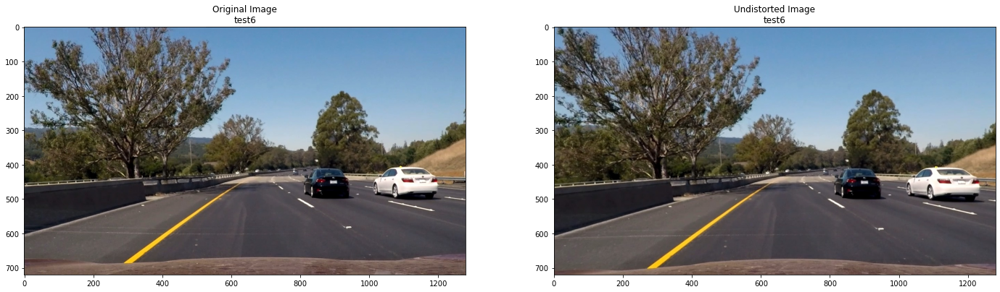

In [20]:
# Make a list of test images
images = ['test_images/'+image for image in os.listdir('test_images/')]

# Initialize count for saving images
count = 1

# Iterate through images and visualize Original and Undistored image
for fname in images:
    # Reads the image
    image = cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB)
    # Undistorts the image
    undist_line_image = undistort_image(image, mtx, dist)

    #Plot both images
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    ax1.imshow(image)
    ax1.set_title('Original Image' + '\n' + fname[12:-4], fontsize=12)
    ax2.imshow(undist_line_image)
    ax2.set_title('Undistorted Image' + '\n' + fname[12:-4], fontsize=12)
    undist_line_image = cv2.cvtColor(undist_line_image, cv2.COLOR_RGB2BGR)
    cv2.imwrite('output_images/undistorted_images/'+str(count)+'.jpg', undist_line_image)
    count+=1

## Perspective Transformation

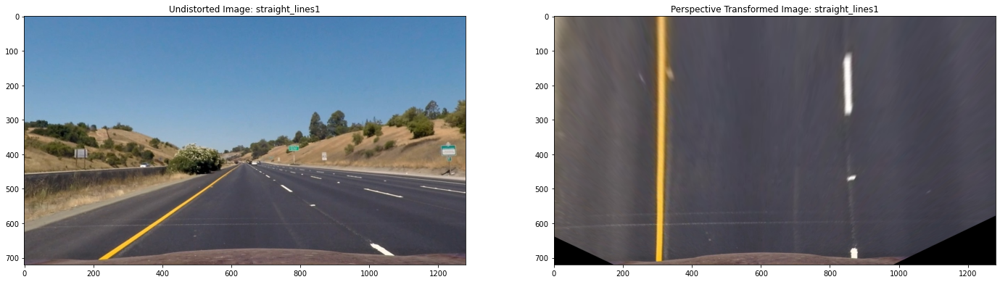

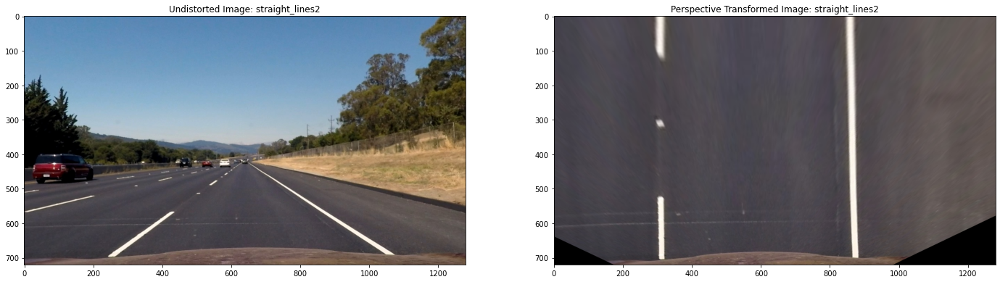

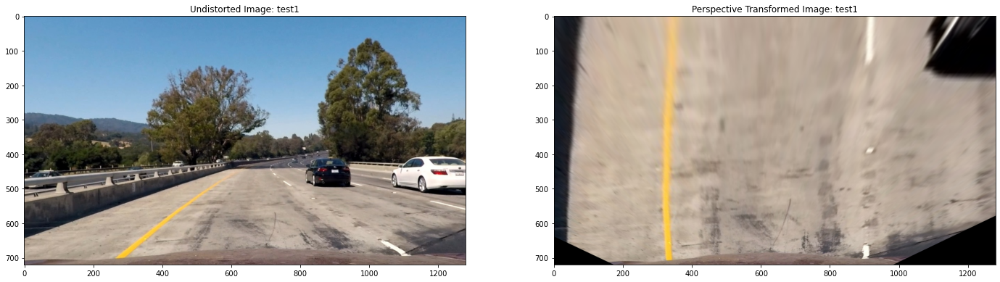

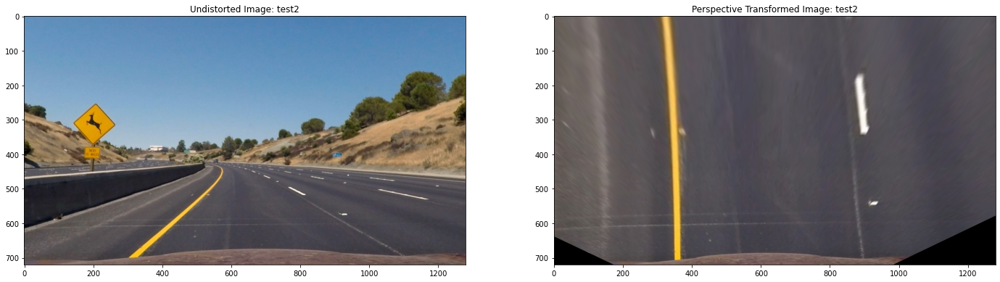

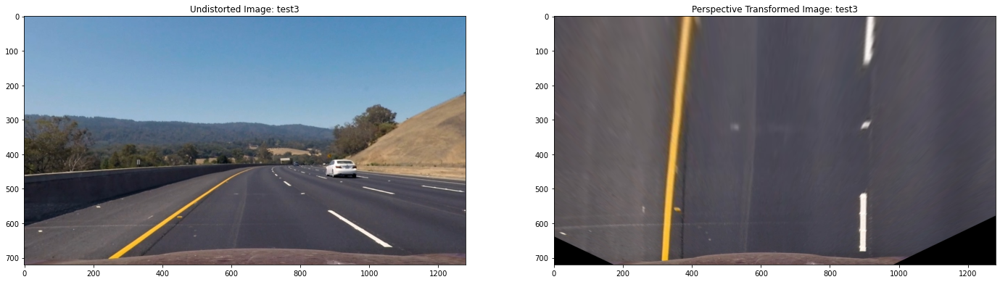

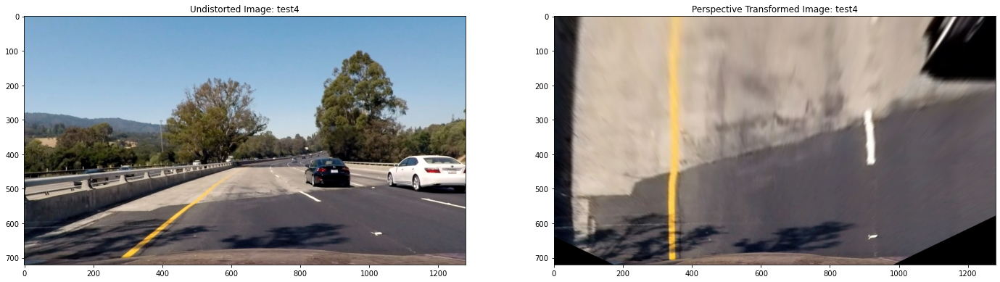

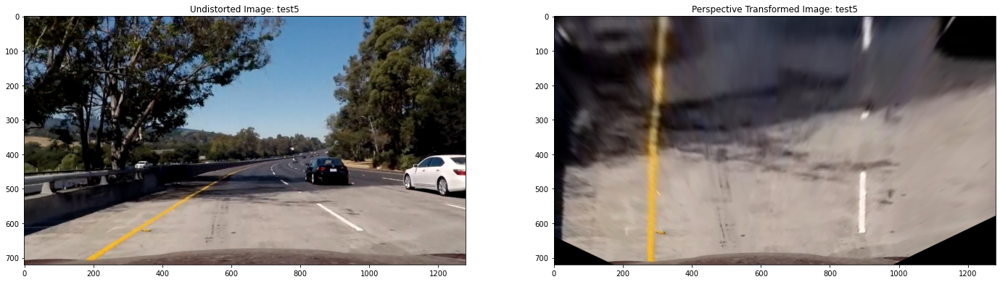

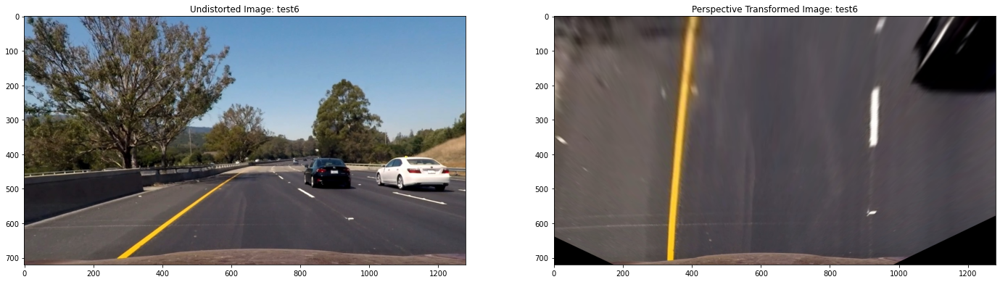

In [24]:
# Iterate through images and visualize Undistorted and Perspective Transformed images
# Initialize count for saving images
count = 1

for fname in images:
    # Reads the image
    image = cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB)
    # Undistorts the image
    undist_line_image = undistort_image(image, mtx, dist)
    # Transforms perspective of image to "bird's eye view"
    perspective_transformed_image, M, Minv = transform_perspective(undist_line_image)
    
    #Plot the Perspectivie Transformed image
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    ax1.imshow(undist_line_image)
    ax1.set_title('Undistorted Image: ' + fname[12:-4], fontsize=12)
    ax2.imshow(perspective_transformed_image)
    ax2.set_title('Perspective Transformed Image: '+ fname[12:-4], fontsize=12)
    perspective_transformed_image = cv2.cvtColor(perspective_transformed_image, cv2.COLOR_RGB2BGR)
    cv2.imwrite('output_images/perspective_transformed_images/'+str(count)+'.jpg', perspective_transformed_image)
    count+=1

## Applying Thresholds

### Binary Thresholds
We will first look at thresholding the image based on various binary thresholds.

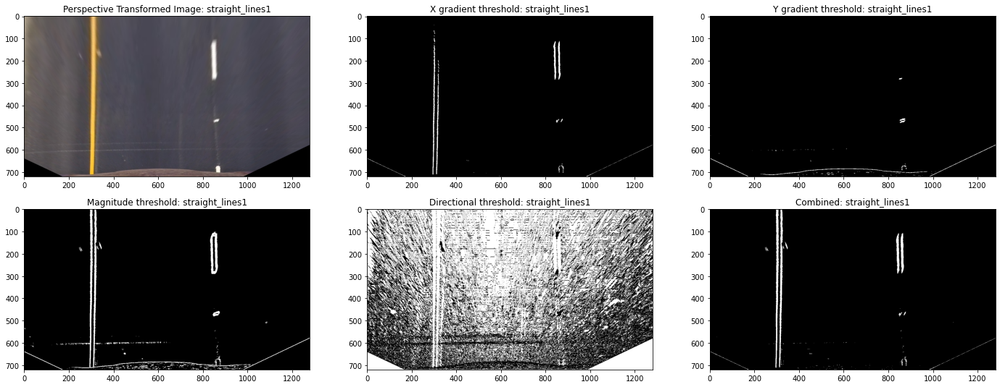

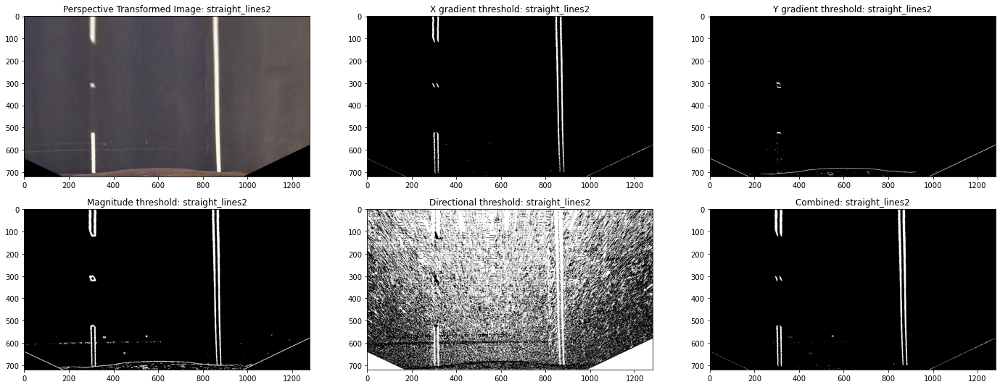

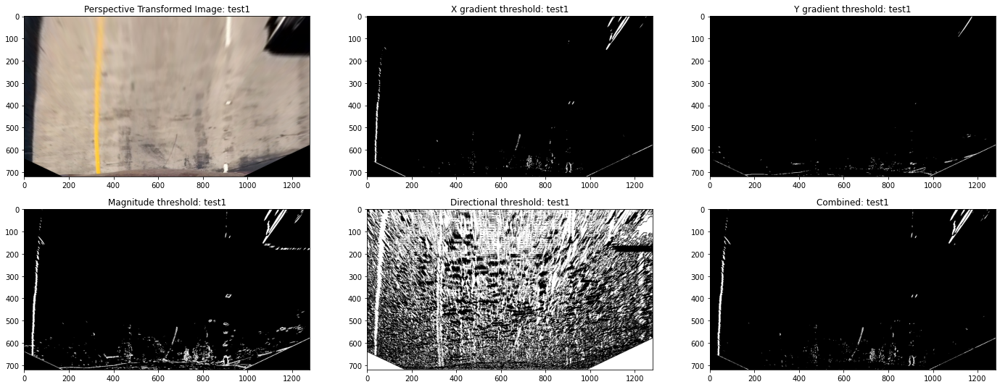

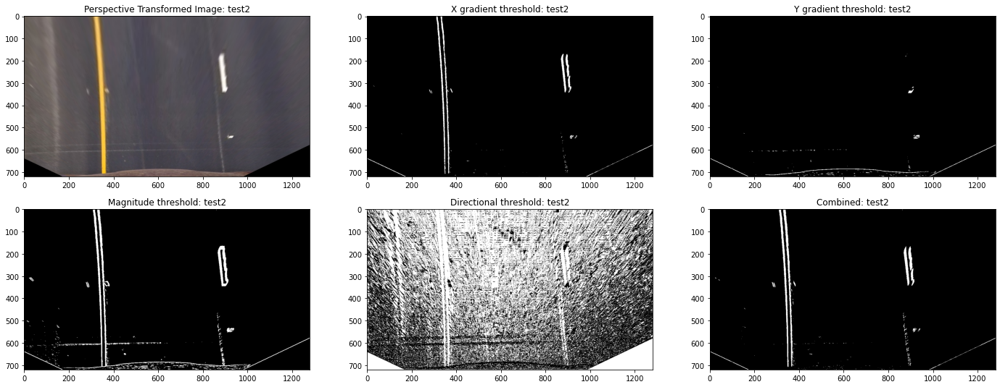

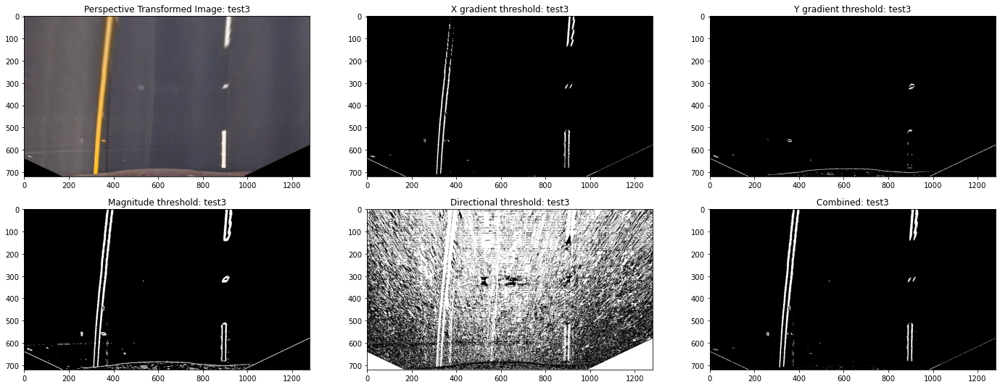

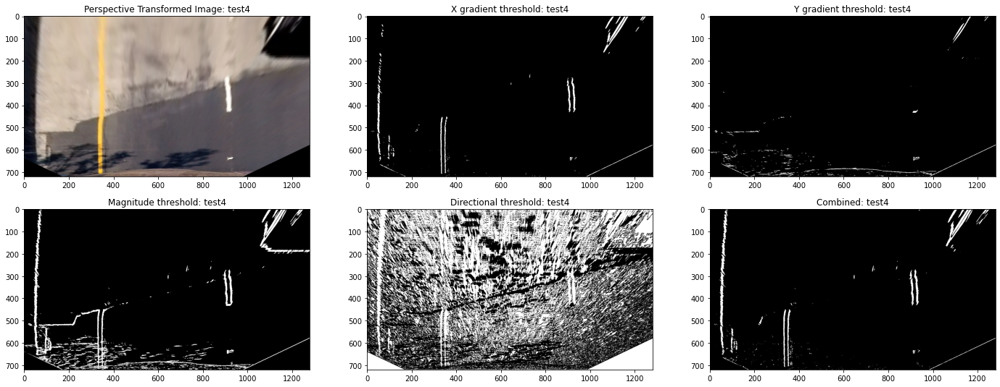

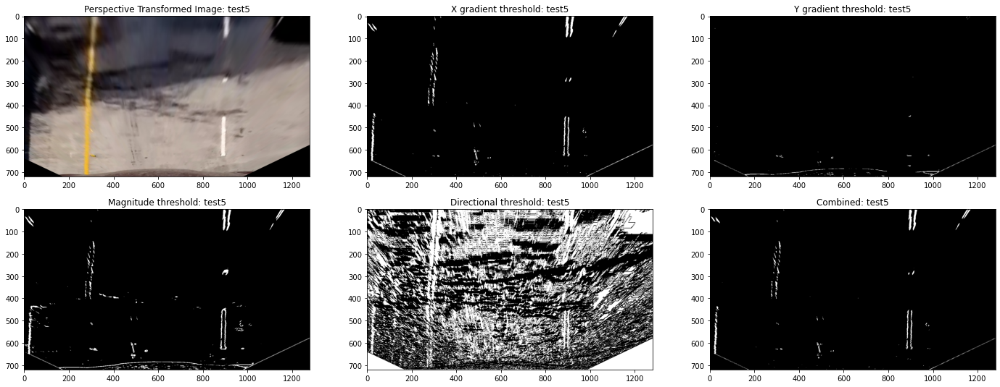

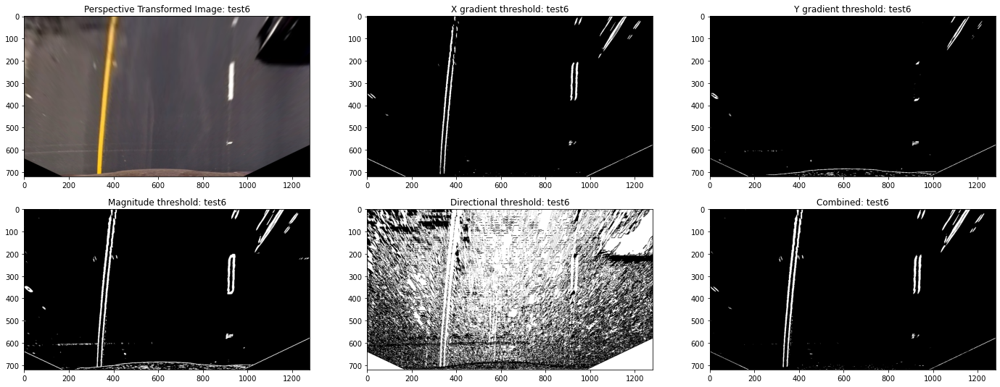

In [28]:
# x-gradient, y-gradient, magnitude, directional and a combination of gradients
# Initialize count for saving images
count = 1

for fname in images:
    # Reads the image
    image = cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB)
    # Undistorts the image
    undist_line_image = undistort_image(image, mtx, dist)
    # Transforms perspective of image to "bird's eye view"
    perspective_transformed_image, M, Minv = transform_perspective(undist_line_image)
    # Applies a gradient across X
    grad_x = abs_sobel_thresh(perspective_transformed_image, 'x', 40, 180)
    # Applies a gradient across Y
    grad_y = abs_sobel_thresh(perspective_transformed_image, 'y', 40, 180)
    # Overall magnitude of the gradient
    mag_binary = mag_thresh(perspective_transformed_image, 3, (20,180))
    # Direction of the gradient
    dir_binary = dir_threshold(perspective_transformed_image, 3, thresh=(0, .7))
    
    # Combining the above thresholds
    combined = np.zeros_like(dir_binary)
    combined[((grad_x == 1) & (grad_y == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    
    #Plot the undistorted image
    f, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(2, 3, figsize=(24, 9))
    ax1.imshow(perspective_transformed_image)
    ax1.set_title('Perspective Transformed Image: ' + fname[12:-4], fontsize=12)
    ax2.imshow(grad_x, cmap = 'gray')
    ax2.set_title('X gradient threshold: '+ fname[12:-4], fontsize=12)
    ax3.imshow(grad_y, cmap = 'gray')
    ax3.set_title('Y gradient threshold: ' + fname[12:-4], fontsize=12)
    ax4.imshow(mag_binary, cmap = 'gray')
    ax4.set_title('Magnitude threshold: ' + fname[12:-4], fontsize=12)
    ax5.imshow(dir_binary, cmap = 'gray')
    ax5.set_title('Directional threshold: ' + fname[12:-4], fontsize=12)
    ax6.imshow(combined, cmap = 'gray')
    ax6.set_title('Combined: ' + fname[12:-4], fontsize=12)
    
    # Saving Images
    #grad_x = cv2.cvtColor(grad_x, cv2.COLOR_RGB2BGR)
    cv2.imwrite('output_images/binary_threshold_images/'+'grad_x_'+str(count)+'.jpg', grad_x)
    #grad_y = cv2.cvtColor(grad_y, cv2.COLOR_RGB2BGR)
    cv2.imwrite('output_images/binary_threshold_images/'+'grad_y_'+str(count)+'.jpg', grad_y)
    #mag_binary = cv2.cvtColor(mag_binary, cv2.COLOR_RGB2BGR)
    cv2.imwrite('output_images/binary_threshold_images/'+'mag_binary_'+str(count)+'.jpg', mag_binary)
    #dir_binary = cv2.cvtColor(dir_binary, cv2.COLOR_RGB2BGR)
    cv2.imwrite('output_images/binary_threshold_images/'+'dir_binary_'+str(count)+'.jpg', dir_binary)
    #combined = cv2.cvtColor(combined, cv2.COLOR_RGB2BGR)
    cv2.imwrite('output_images/binary_threshold_images/'+'combined_'+str(count)+'.jpg', combined)
    
    count+=1

As we can see above certain thresholds are better able to identify the lines than others. In particular X gradient and magnitude gradients perform the best.

### Color Thresholds
Next we will apply color, HLS and HSV thresholds

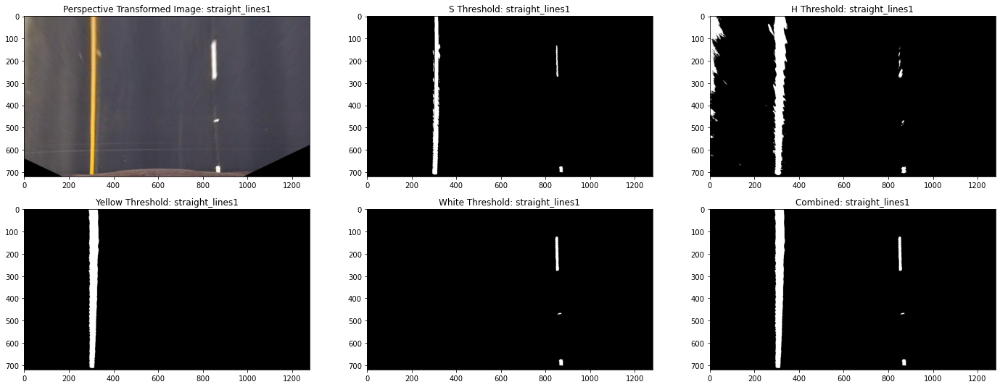

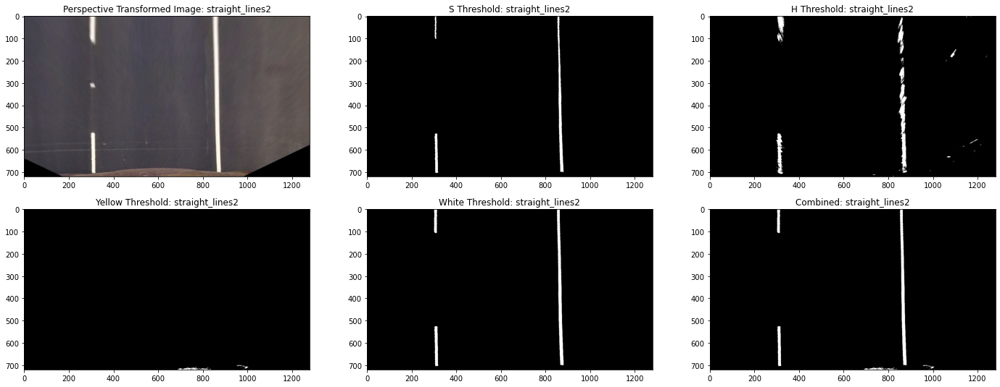

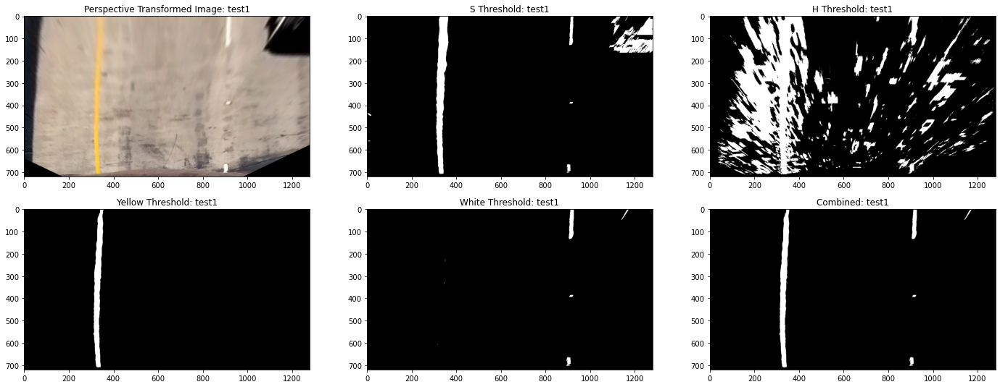

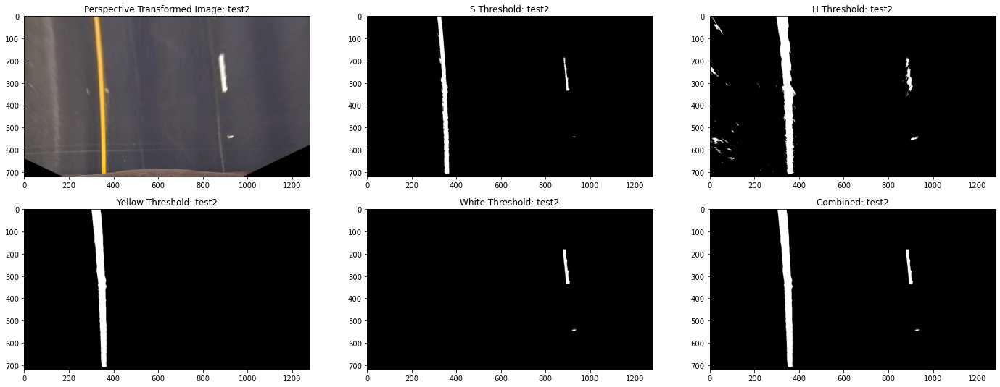

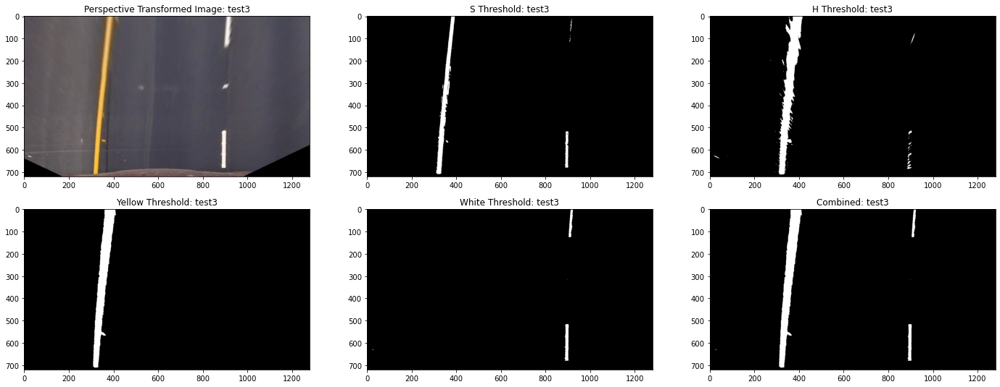

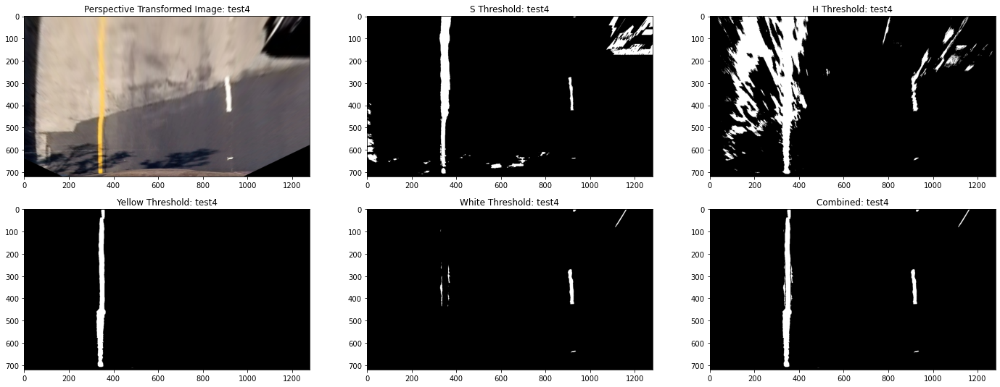

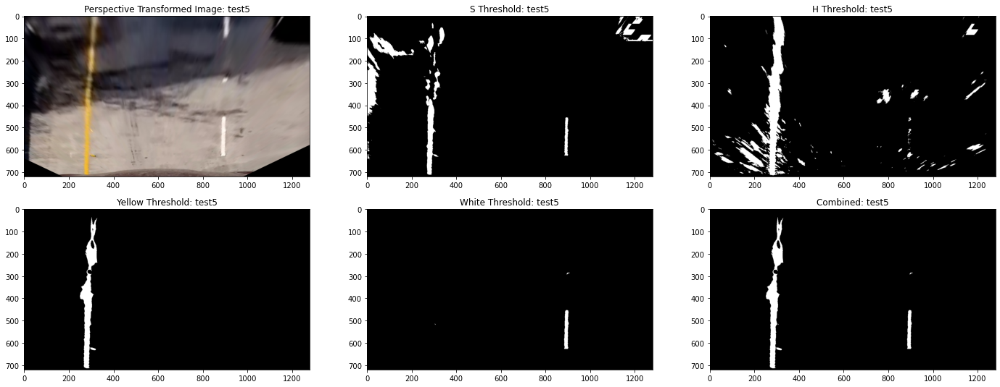

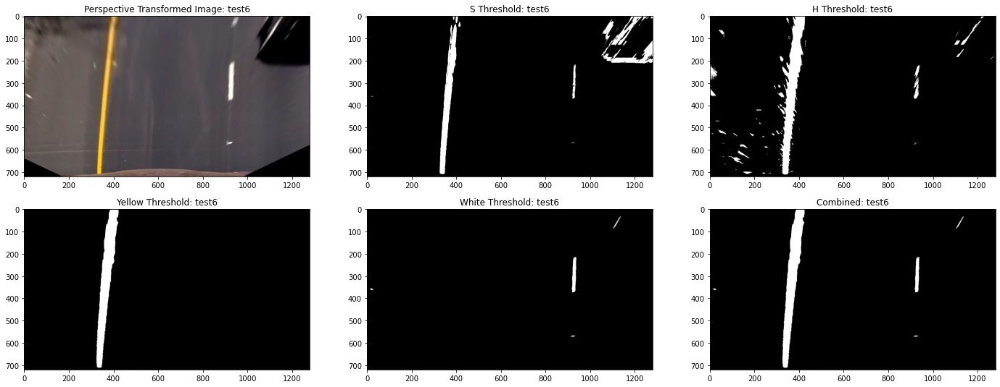

In [29]:
# Initialize count for saving images
count = 1

for fname in images:
    # Reads the image
    image = cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB)
    # Undistorts the image
    undist_line_image = undistort_image(image, mtx, dist)
    # Transforms perspective of image to "bird's eye view"
    perspective_transformed_image, M, Minv = transform_perspective(undist_line_image)
    # Applies threshold for S-Channel (Saturation)
    s_thresh = hls_threshold(perspective_transformed_image, 'S', (120,255))
    # Applies threshold for L-Channel (Light)
    l_thresh = hls_threshold(perspective_transformed_image, 'L', (150,255))
    # Applies threshold for H-Channel (Hue)
    h_thresh = hls_threshold(perspective_transformed_image, 'H', (15,75))
    # Applies threshold for V-Channel (Value)
    #v_thresh = hls_threshold(perspective_transformed_image, 'V', (0,255))
    # Applies threshold for the color white
    white_thresh = color_threshold(perspective_transformed_image, white_lower, white_upper)
    # Applies threshold for the color yellow
    yellow_thresh = color_threshold(perspective_transformed_image, yellow_lower, yellow_upper)
        
    # Combining the above color thresholds
    combined = np.zeros_like(white_thresh)
    combined[((white_thresh == 1) | (yellow_thresh == 1))] = 1
    # Combining yellow and white thresholds from above
    mask_lane = cv2.bitwise_or(yellow_thresh,white_thresh)
    
    #Plot the undistorted image
    f, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(2, 3, figsize=(24, 9))
    ax1.imshow(perspective_transformed_image)
    ax1.set_title('Perspective Transformed Image: ' + fname[12:-4], fontsize=12)
    ax2.imshow(s_thresh, cmap = 'gray')
    ax2.set_title('S Threshold: ' + fname[12:-4], fontsize=12)
    ax3.imshow(h_thresh, cmap = 'gray')
    ax3.set_title('H Threshold: ' + fname[12:-4], fontsize=12)
    ax4.imshow(yellow_thresh, cmap = 'gray')
    ax4.set_title('Yellow Threshold: ' + fname[12:-4], fontsize=12)
    ax5.imshow(white_thresh, cmap = 'gray')
    ax5.set_title('White Threshold: ' + fname[12:-4], fontsize=12)
    ax6.imshow(mask_lane, cmap = 'gray')
    ax6.set_title('Combined: ' + fname[12:-4], fontsize=12)
    
    # Saving Images
    #s_thresh = cv2.cvtColor(s_thresh, cv2.COLOR_RGB2BGR)
    cv2.imwrite('output_images/color_threshold_images/'+'s_thresh_'+str(count)+'.jpg', s_thresh)
    #h_thresh = cv2.cvtColor(h_thresh, cv2.COLOR_RGB2BGR)
    cv2.imwrite('output_images/color_threshold_images/'+'h_thresh_'+str(count)+'.jpg', h_thresh)
    #yellow_thresh = cv2.cvtColor(yellow_thresh, cv2.COLOR_RGB2BGR)
    cv2.imwrite('output_images/color_threshold_images/'+'yellow_thresh_'+str(count)+'.jpg', yellow_thresh)
    #white_thresh = cv2.cvtColor(white_thresh, cv2.COLOR_RGB2BGR)
    cv2.imwrite('output_images/color_threshold_images/'+'white_thresh_'+str(count)+'.jpg', white_thresh)
    #combined = cv2.cvtColor(combined, cv2.COLOR_RGB2BGR)
    cv2.imwrite('output_images/color_threshold_images/'+'combined_'+str(count)+'.jpg', combined)
    
    count+=1

This is the best combination that could be found that clearly identified the lane lines. Overall color thresholding performed best when trying to identify the lane lines while not having additional noise. The yellow and white combined thresholding image will be used going forward.

## Fitting Polynomial to Lane Lines

### Defining a histogram of lane line points

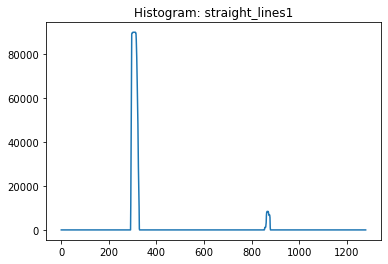

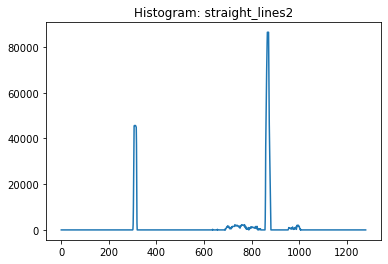

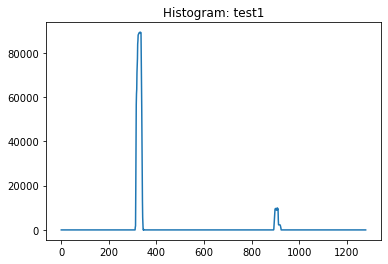

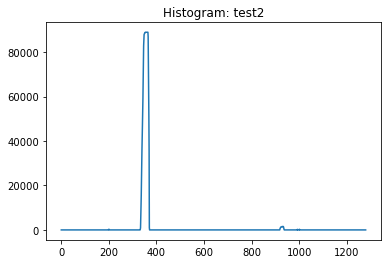

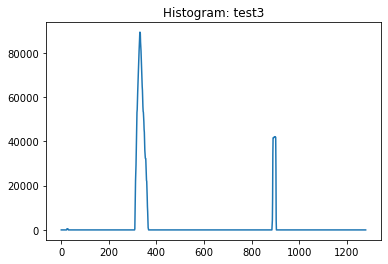

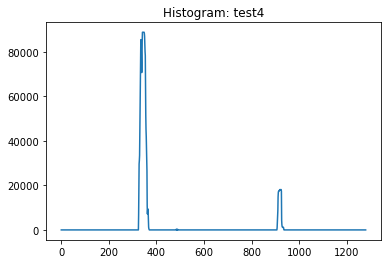

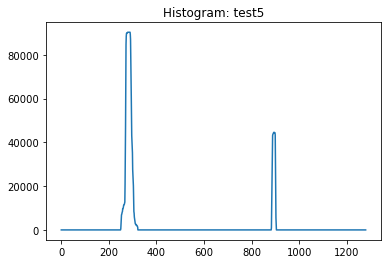

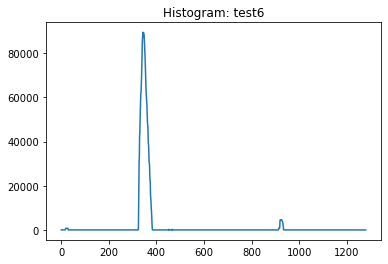

In [31]:
# Creates histograme for white pixels found in each color thresholded image
for fname in images:
    # Reads the image
    image = cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB)
    # Undistorts the image
    undist_line_image = undistort_image(image, mtx, dist)
    # Transforms perspective of image to "bird's eye view"
    perspective_transformed_image, M, Minv = transform_perspective(undist_line_image)
    # Applies threshold for the color white
    white_thresh = color_threshold(perspective_transformed_image, white_lower, white_upper)
    # Applies threshold for the color yellow
    yellow_thresh = color_threshold(perspective_transformed_image, yellow_lower, yellow_upper)
    # Combining yellow and white thresholds from above
    mask_lane = cv2.bitwise_or(yellow_thresh,white_thresh)
    histogram = hist(mask_lane)
    
    # Plotting the histogram
    plt.plot(histogram)
    plt.title('Histogram: ' + fname[12:-4], fontsize=12)
    plt.show()

### Creating a polynomial to fit lane line points  (sliding box method)

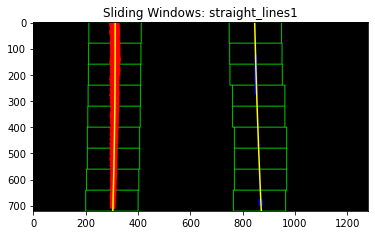

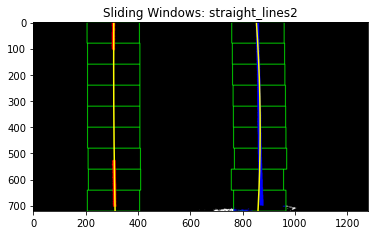

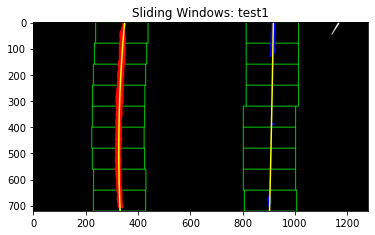

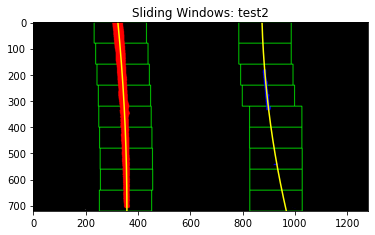

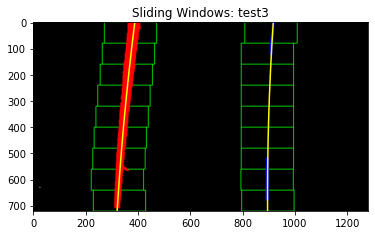

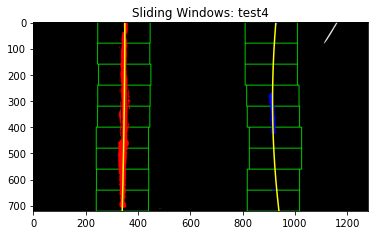

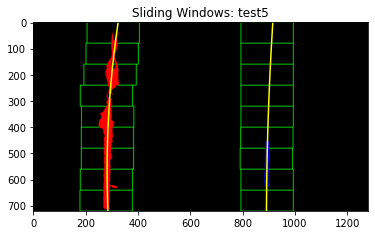

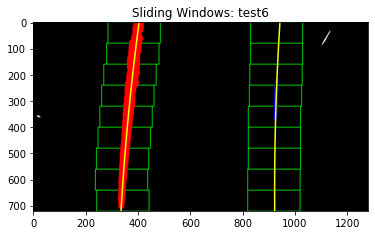

In [37]:
# Initialize count for saving images
count = 1

# Fits a polynomial (yellow line) by only using pixels in the sliding box (green)
for fname in images:
    # Reads the image
    image = cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB)
    # Undistorts the image
    undist_line_image = undistort_image(image, mtx, dist)
    # Transforms perspective of image to "bird's eye view"
    perspective_transformed_image, M, Minv = transform_perspective(undist_line_image)
    # Applies threshold for the color white
    white_thresh = color_threshold(perspective_transformed_image, white_lower, white_upper)
    # Applies threshold for the color yellow
    yellow_thresh = color_threshold(perspective_transformed_image, yellow_lower, yellow_upper)
    # Combining yellow and white thresholds from above
    binary_warped = cv2.bitwise_or(yellow_thresh,white_thresh)
    histogram = hist(binary_warped)
    
    # Gets image of thresholded lane lines and applies polynomial
    out_img, ploty, (left_fit, right_fit), x_pixel_values = fit_polynomial(binary_warped)
    
    # Plots result
    plt.imshow(out_img)
    plt.title('Sliding Windows: ' + fname[12:-4], fontsize=12)
    plt.show()
    
    cv2.imwrite('output_images/sliding_box_images/'+str(count)+'.jpg', out_img)
    count+=1

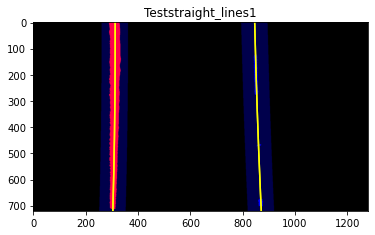

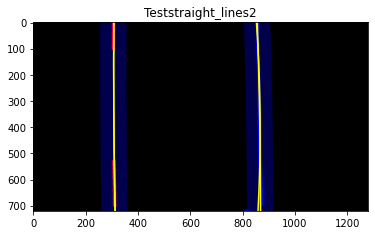

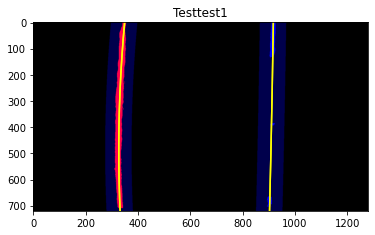

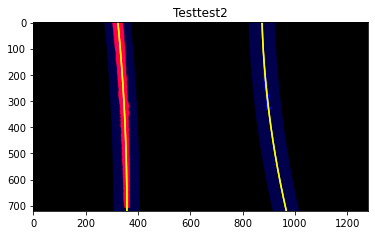

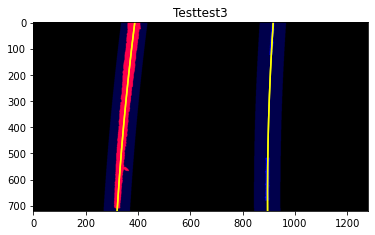

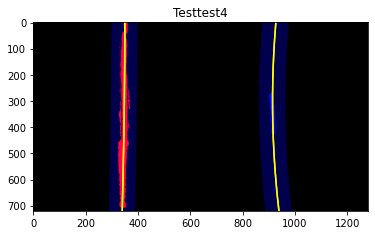

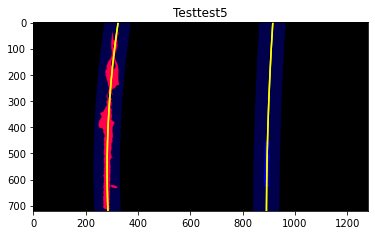

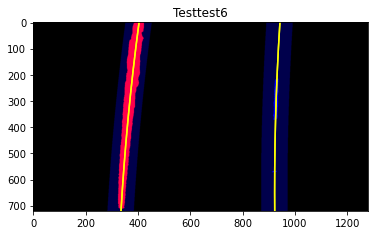

In [38]:
# Initialize count for saving images
count = 1

# Fills lane area of image between left and right polynomials
for fname in images:
    # Reads the image
    image = cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB)
    # Undistorts the image
    undist_line_image = undistort_image(image, mtx, dist)
    # Transforms perspective of image to "bird's eye view"
    perspective_transformed_image, M, Minv = transform_perspective(undist_line_image)
    # Applies threshold for the color white
    white_thresh = color_threshold(perspective_transformed_image, white_lower, white_upper)
    # Applies threshold for the color yellow
    yellow_thresh = color_threshold(perspective_transformed_image, yellow_lower, yellow_upper)
    # Combining yellow and white thresholds from above
    binary_warped = cv2.bitwise_or(yellow_thresh,white_thresh)
    histogram = hist(binary_warped)
    
    # Gets image of thresholded lane lines and applies polynomial
    out_img, ploty, (left_fit, right_fit), x_pixel_values = fit_polynomial(binary_warped)
    out_img, result, left_fitx, right_fitx = fill_lane_lines(binary_warped)
        
    plt.imshow(result)
    plt.title('Test' + fname[12:-4], fontsize=12)
    plt.show()
    
    cv2.imwrite('output_images/lane_margin_images/'+str(count)+'.jpg', out_img)
    count+=1

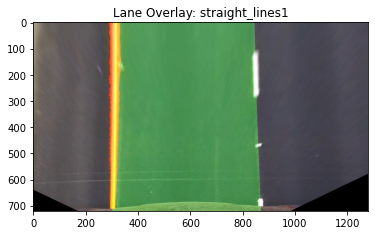

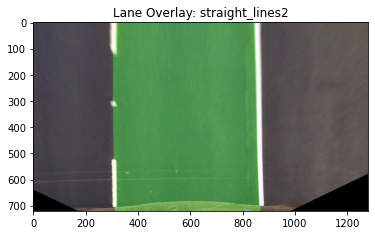

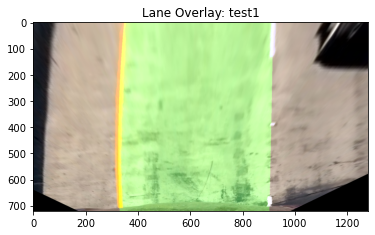

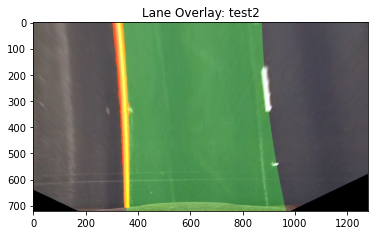

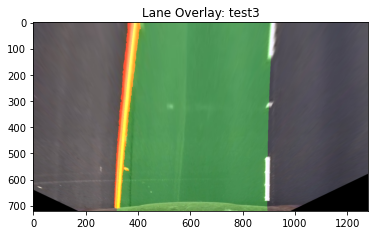

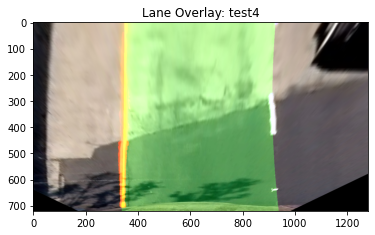

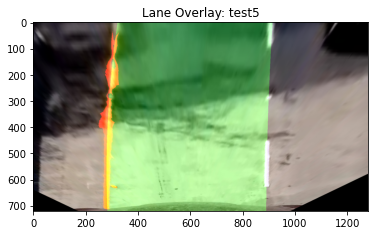

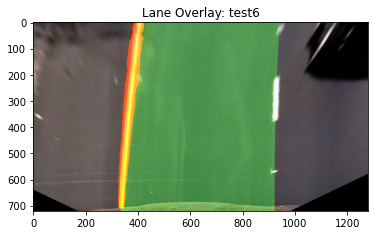

In [41]:
# Overlays shaded region and polynomial with perspective transformed image
for fname in images:
    # Reads the image
    image = cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB)
    # Undistorts the image
    undist_line_image = undistort_image(image, mtx, dist)
    # Transforms perspective of image to "bird's eye view"
    perspective_transformed_image, M, Minv = transform_perspective(undist_line_image)
    # Applies threshold for the color white
    white_thresh = color_threshold(perspective_transformed_image, white_lower, white_upper)
    # Applies threshold for the color yellow
    yellow_thresh = color_threshold(perspective_transformed_image, yellow_lower, yellow_upper)
    # Combining yellow and white thresholds from above
    binary_warped = cv2.bitwise_or(yellow_thresh,white_thresh)
    histogram = hist(binary_warped)
    
    # Gets image of thresholded lane lines and applies polynomial
    out_img, ploty, (left_fit, right_fit), x_pixel_values = fit_polynomial(binary_warped)
    out_img, result, left_fitx, right_fitx = fill_lane_lines(binary_warped)
    
    # Draw lane lines on undistorted image
    new_result = cv2.addWeighted(perspective_transformed_image, 1, result, 1, 0)
    
    # Plots result
    plt.imshow(new_result)
    plt.title('Lane Overlay: ' + fname[12:-4], fontsize=12)
    plt.show()

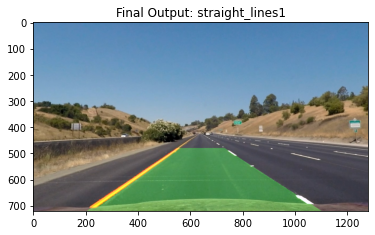

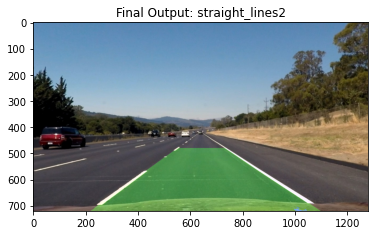

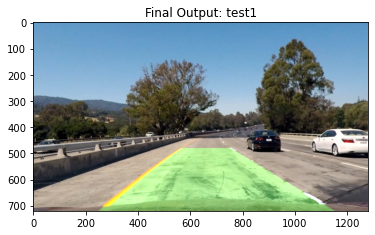

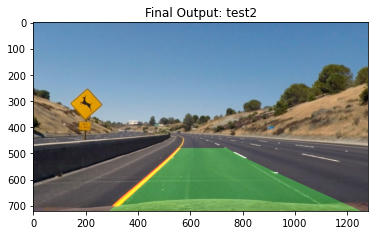

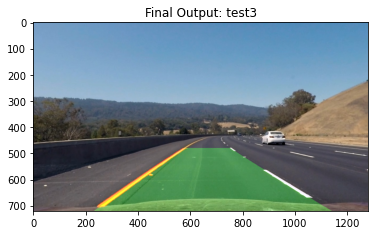

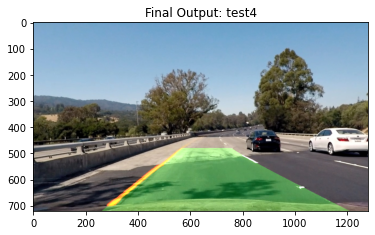

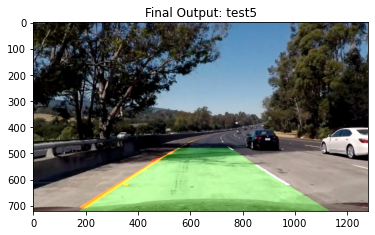

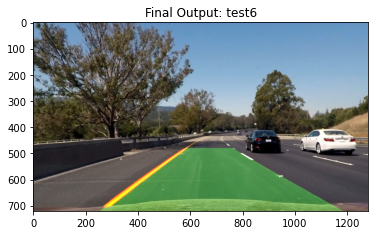

In [42]:
# Reverses perspective transform of the shaded area and overlays with original undistorted image
for fname in images:
    # Reads the image
    image = cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB)
    # Undistorts the image
    undist_line_image = undistort_image(image, mtx, dist)
    # Transforms perspective of image to "bird's eye view"
    perspective_transformed_image, M, Minv = transform_perspective(undist_line_image)
    # Applies threshold for the color white
    white_thresh = color_threshold(perspective_transformed_image, white_lower, white_upper)
    # Applies threshold for the color yellow
    yellow_thresh = color_threshold(perspective_transformed_image, yellow_lower, yellow_upper)
    # Combining yellow and white thresholds from above
    binary_warped = cv2.bitwise_or(yellow_thresh,white_thresh)
    histogram = hist(binary_warped)
    
    # Gets image of thresholded lane lines and applies polynomial
    out_img, ploty, (left_fit, right_fit), x_pixel_values = fit_polynomial(binary_warped)
    out_img, result, left_fitx, right_fitx = fill_lane_lines(binary_warped)
    
    # Draw lane lines on undistorted image
    new_result = cv2.addWeighted(perspective_transformed_image, 1, result, 1, 0)
    # Reverses perspective transform of shaded region
    reversed_image = reverse_transform_perspective(result, Minv)
    # Overlays with original undistorted image
    final_image = cv2.addWeighted(undist_line_image, 1, reversed_image, 1, 0)
    
    # Plots Final Result
    plt.imshow(final_image)
    plt.title('Final Output: ' + fname[12:-4], fontsize=12)
    plt.show()

## Video

In [43]:
def video_pipeline(image):
    # Undistorts the image
    undist_line_image = undistort_image(image, mtx, dist)
    # Transforms perspective of image to "bird's eye view"
    perspective_transformed_image, M, Minv = transform_perspective(undist_line_image)
    # Applies threshold for the color white
    white_thresh = color_threshold(perspective_transformed_image, white_lower, white_upper)
    # Applies threshold for the color yellow
    yellow_thresh = color_threshold(perspective_transformed_image, yellow_lower, yellow_upper)
    # Combining yellow and white thresholds from above
    binary_warped = cv2.bitwise_or(yellow_thresh,white_thresh)
    histogram = hist(binary_warped)
    
    # Gets image of thresholded lane lines and applies polynomial
    out_img, ploty, (left_fit, right_fit), x_pixel_values = fit_polynomial(binary_warped)
    out_img, result, left_fitx, right_fitx = fill_lane_lines(binary_warped)
    
    # Draw lane lines on undistorted image
    new_result = cv2.addWeighted(perspective_transformed_image, 1, result, 1, 0)
    # Reverses perspective transform of shaded region
    reversed_image = reverse_transform_perspective(result, Minv)
    # Overlays with original undistorted image
    final_image = cv2.addWeighted(undist_line_image, 1, reversed_image, 1, 0)
    
    return final_image

In [44]:
from moviepy.editor import VideoFileClip

output = 'project_video_output.mp4'
clip1 = VideoFileClip("project_video.mp4").subclip(30,35)
white_clip = clip1.fl_image(video_pipeline)#NOTE: this function expects color images!!
%time white_clip.write_videofile(output, audio=False)

t:   0%|          | 0/125 [00:00<?, ?it/s, now=None]

Moviepy - Building video project_video_output.mp4.
Moviepy - Writing video project_video_output.mp4



Moviepy - Done !
Moviepy - video ready project_video_output.mp4
Wall time: 17.9 s
